# Pancreatic endocrinogenesis

This tutorial uses raw data from [scvelo](https://github.com/theislab/scvelo) package. Special thanks goes to the scvelo team! 

In [ ]:
# get the latest version from pypi 
# for other installations approaches, see https://dynamo-release.readthedocs.io/en/latest/ten_minutes_to_dynamo.html#how-to-install
!pip install dynamo-release --upgrade --quiet

In [1]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:90% !important; }</style>"))
# %matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn 

this is like R's sessionInfo()

In [2]:
dyn.get_all_dependencies_version()

package,dynamo-release,umap-learn,anndata,cvxopt,hdbscan,loompy,matplotlib,numba,numpy,pandas,pynndescent,python-igraph,scikit-learn,scipy,seaborn,setuptools,statsmodels,tqdm,trimap,numdifftools,colorcet
version,0.95.2,0.4.6,0.7.4,1.2.3,0.8.26,3.0.6,3.3.0,0.51.0,1.19.1,1.1.1,0.4.8,0.8.2,0.23.2,1.5.2,0.9.0,49.6.0,0.11.1,4.48.2,1.0.12,0.9.39,2.0.2


estimating gamma: 100%|██████████| 1000/1000 [00:27<00:00, 36.51it/s]
calculating transition matrix via pearson kernel with sqrt transform.: 100%|██████████| 3696/3696 [00:05<00:00, 697.37it/s]
projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:00<00:00, 3915.76it/s]


<Figure size 600x400 with 0 Axes>

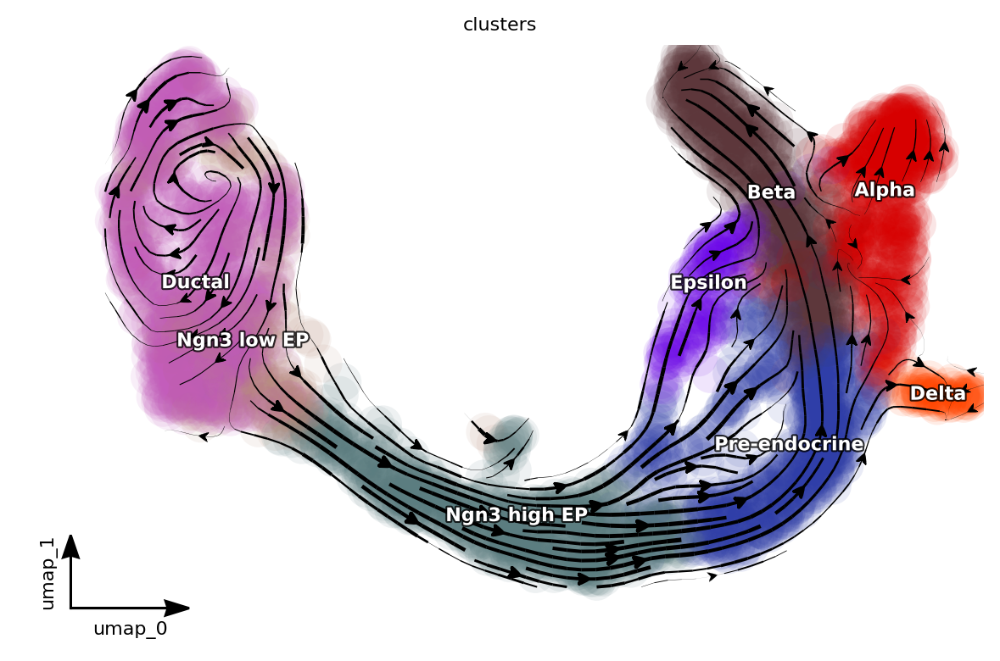

In [3]:
# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata = dyn.sample_data.pancreatic_endocrinogenesis()

dyn.pp.recipe_monocle(adata, n_top_genes=1000, fg_kwargs={'shared_count': 20})

dyn.tl.dynamics(adata, model='stochastic')

dyn.tl.reduceDimension(adata, n_pca_components=30)

dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'})
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data', show_arrowed_spines=True)


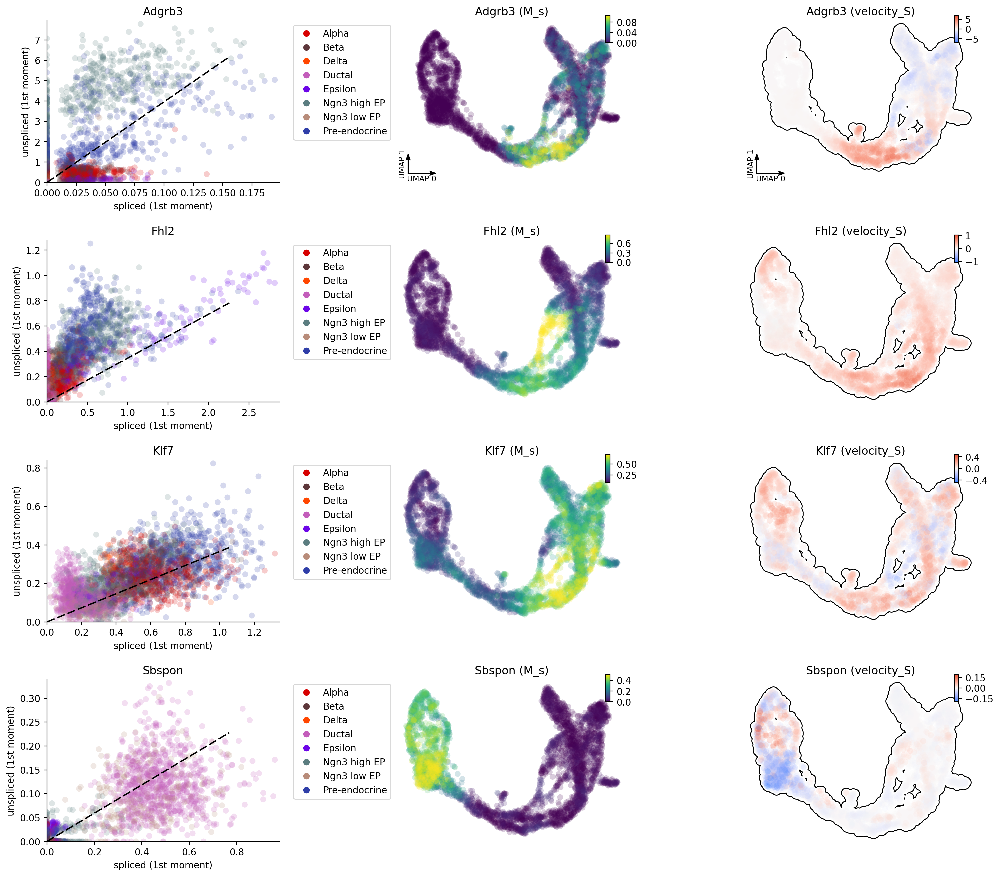

In [4]:
dyn.pl.phase_portraits(adata, genes=adata.var_names[adata.var.use_for_dynamics][:4], figsize=(6, 4), color='clusters')

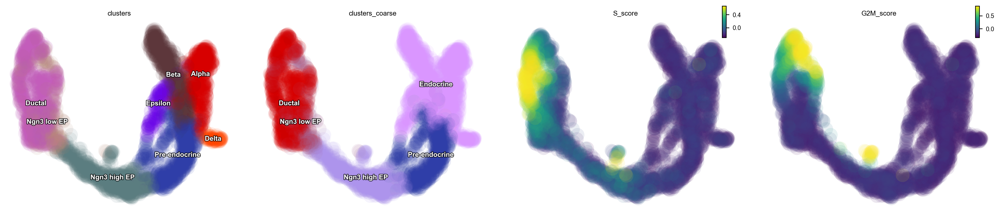

In [5]:
dyn.pl.umap(adata, color=['clusters', 'clusters_coarse', "S_score", "G2M_score"], ncols=4, alpha=0.1)

<Figure size 600x400 with 0 Axes>

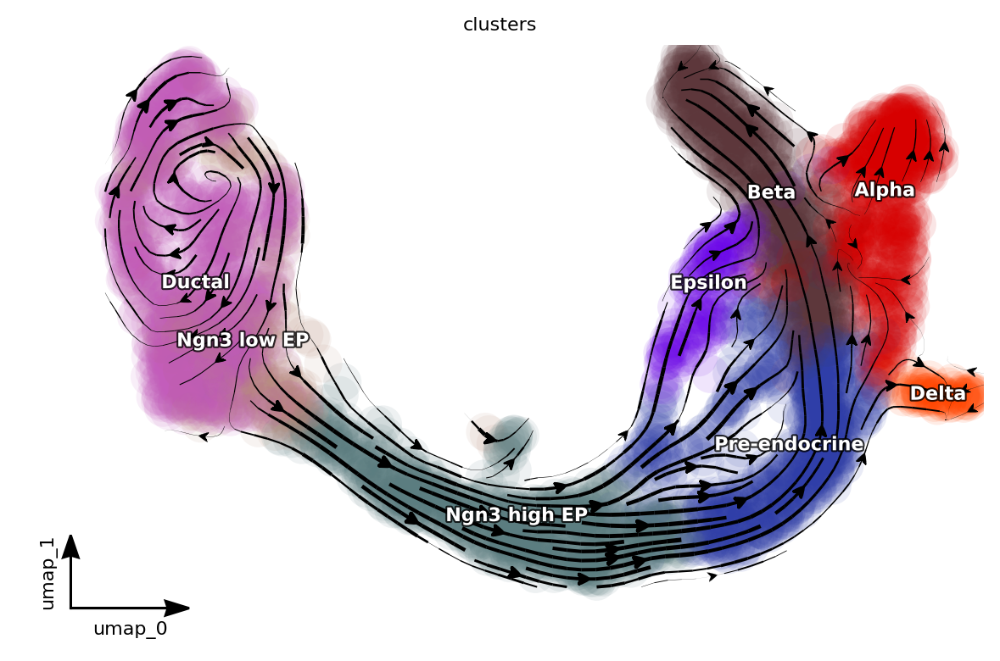

In [6]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', show_legend='on data')


<Figure size 800x600 with 0 Axes>

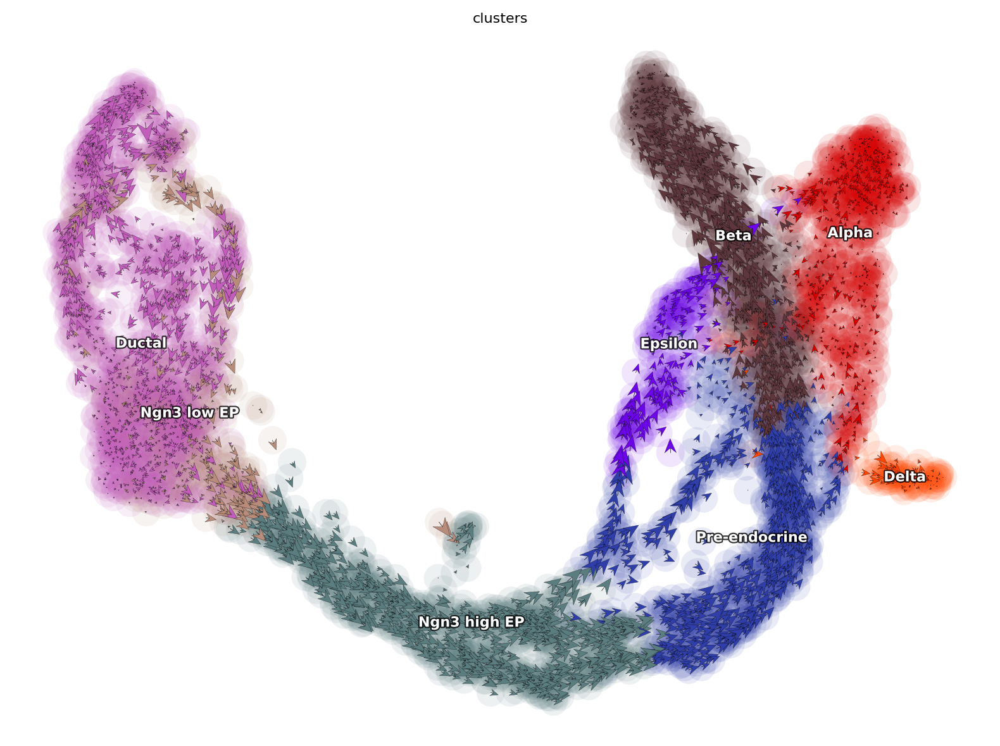

In [7]:
dyn.pl.cell_wise_vectors(adata, color=['clusters'], basis='umap', show_legend='on data', quiver_length=6, quiver_size=6, figsize=(8, 6), show_arrowed_spines=False)


In [8]:
# ok some exciting vector field analysis 

# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction

dyn.vf.VectorField(adata, basis='umap', pot_curl_div=True) # , M=1000, MaxIter=1000


Constructing diffusion graph from reconstructed vector field: 3696it [00:53, 68.51it/s]
Calculating divergence: 100%|██████████| 3696/3696 [00:00<00:00, 16217.06it/s]


<Figure size 600x400 with 0 Axes>

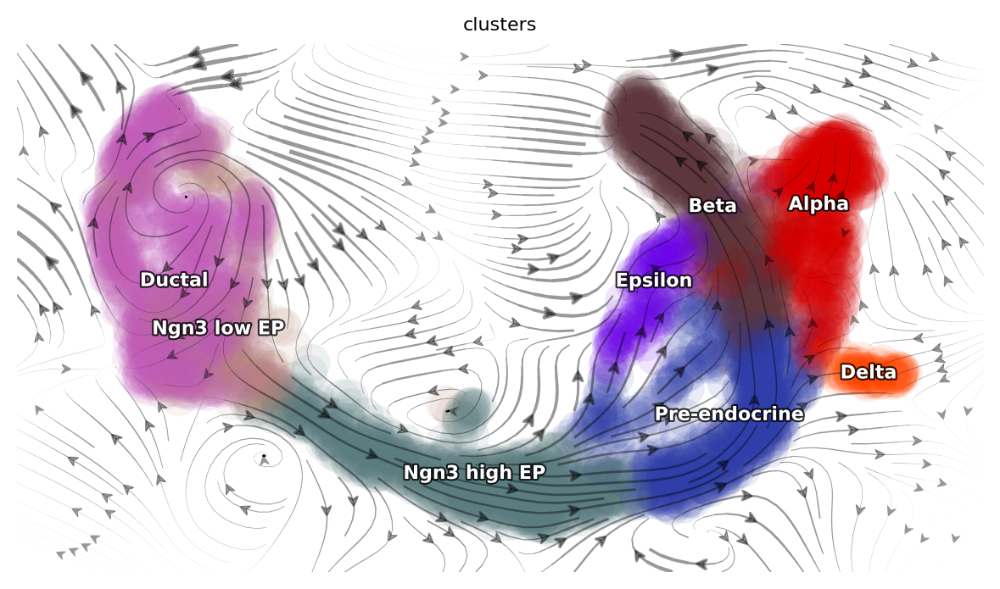

In [9]:
dyn.pl.topography(adata, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', show_legend='on data', terms=("streamline"))


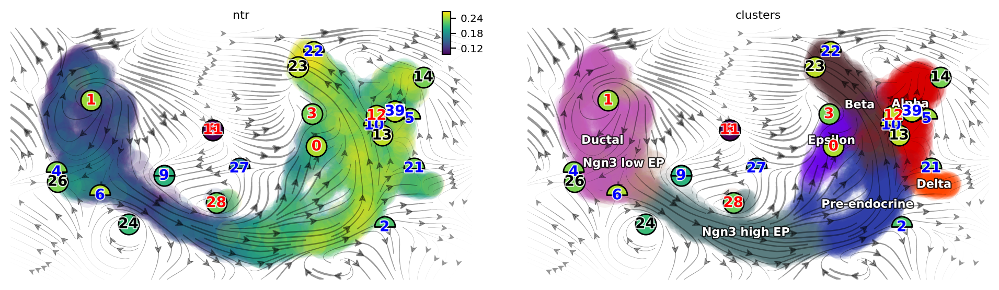

In [10]:
dyn.pl.topography(adata, basis='umap', background='white', color=['ntr', 'clusters'], streamline_color='black', show_legend='on data')


In [11]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata)
dyn.vf.divergence(adata)
dyn.vf.acceleration(adata)
dyn.vf.curl(adata)

projecting velocity vector to low dimensional embedding...:  20%|██        | 749/3696 [00:00<00:00, 3466.44it/s]

Using existing pearson_transition_matrix found in .obsp.


projecting velocity vector to low dimensional embedding...: 100%|██████████| 3696/3696 [00:00<00:00, 3923.20it/s]
Calculating 2-D curl: 100%|██████████| 3696/3696 [00:00<00:00, 18994.08it/s]


In [12]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'speed_umap', 'divergence_pca', 'acceleration_umap'
    var: 'highly_variable_genes', 'pass_basic_filter', 'log_m', 'score', 'log_cv', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'velocyto_SVR', 'pp_norm_method', 'PCs', 'explained_variance_ratio_', 'pca_fit', 'feature_selection', 'dynamics', 'grid_velocity_umap', 'VecFl

this just shows how flexible dynamo' plotting function can be. 

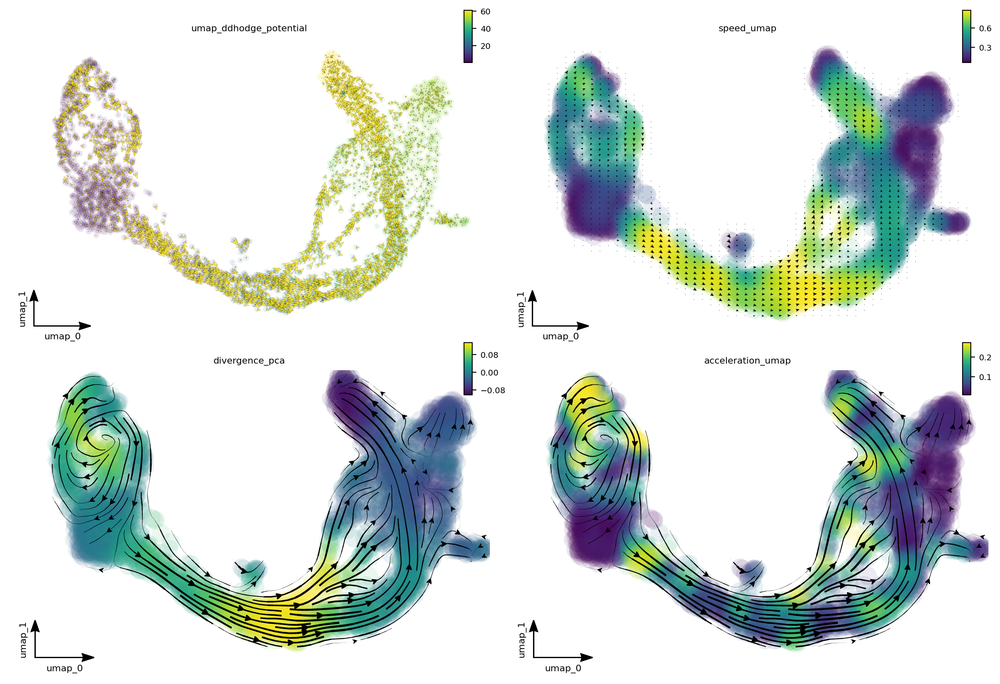

In [13]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return')
plt.show()

In [14]:
# emulate ggplot2 plotting styple with black background
dyn.configuration.set_figure_params('dynamo', background='black')  

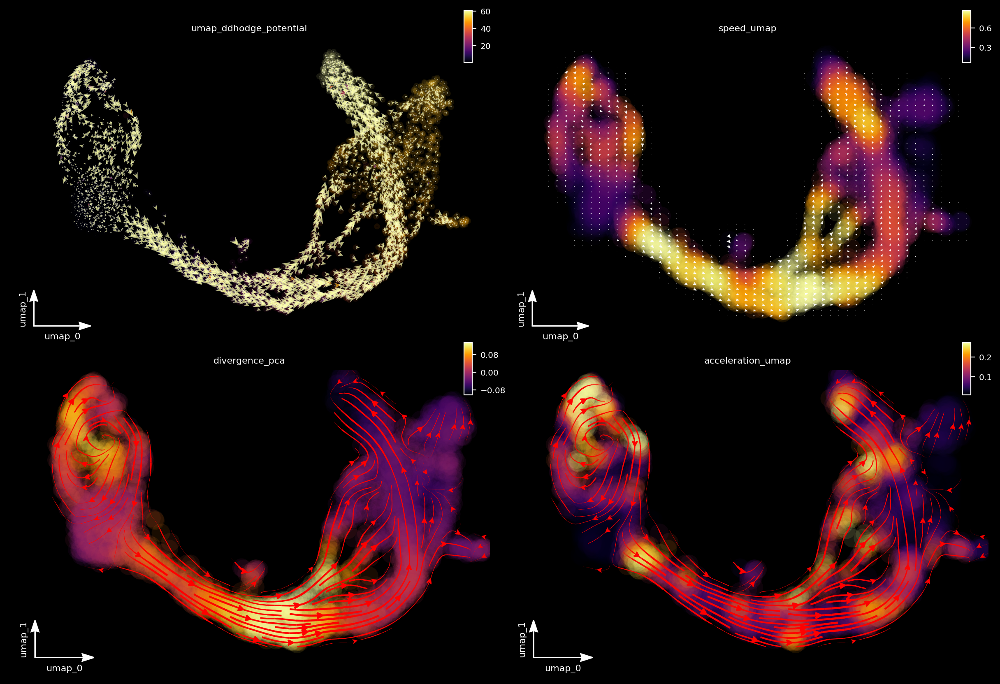

In [15]:
fig1, f1_axes = plt.subplots(ncols=2, nrows=2, constrained_layout=True, figsize=(12, 8))
f1_axes
f1_axes[0, 0] = dyn.pl.cell_wise_vectors(adata, color='umap_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0, 0], quiver_length=6, quiver_size=6, save_show_or_return='return', background='black')
f1_axes[0, 1] = dyn.pl.grid_vectors(adata, color='speed_umap', ax=f1_axes[0, 1], quiver_length=12, quiver_size=12, save_show_or_return='return', background='black')
f1_axes[1, 0] = dyn.pl.streamline_plot(adata, color='divergence_pca', ax=f1_axes[1, 0], save_show_or_return='return', background='black')
f1_axes[1, 1] = dyn.pl.streamline_plot(adata, color='acceleration_umap', ax=f1_axes[1, 1], save_show_or_return='return', background='black')
plt.show()

In [16]:
progenitor = adata.obs_names[adata.obs.clusters.isin(['Ductal'])]
len(progenitor)

916

In [17]:
import numpy as np 
dyn.pd.fate(adata, basis='umap', init_cells=np.random.choice(progenitor, 100), interpolation_num=100,  direction='forward',
   inverse_transform=False, average=False, cores=3)

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'Size_Factor', 'initial_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'speed_umap', 'divergence_pca', 'acceleration_umap'
    var: 'highly_variable_genes', 'pass_basic_filter', 'log_m', 'score', 'log_cv', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'velocyto_SVR', 'pp_norm_method', 'PCs', 'explained_variance_ratio_', 'pca_fit', 'feature_selection', 'dynamics', 'grid_velocity_umap', 'VecFl

In [18]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', ax=ax, save_show_or_return='return')

In [19]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=adata, ax=ax, color='clusters')

In [20]:
from matplotlib import animation
import numpy as np 

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                                frames=np.arange(100), interval=100, blit=True)
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.

Animation size has reached 21113254 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [21]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', ax=ax, save_show_or_return='return')
dyn.mv.animate_fates(adata, color='clusters', basis='umap', n_steps=200, fig=fig, ax=ax, 
                     save_show_or_return='save', logspace=True, max_time=None, save_kwargs={"filename": 'pancreas.gif'})
